In [1]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['font.sans-serif'] = ['Times New Roman']
plt.rcParams['figure.dpi'] = 500
plt.rcParams['text.color'] = 'w'
plt.rcParams['axes.labelcolor'] = 'k'
plt.rcParams['xtick.color'] = 'w'
plt.rcParams['ytick.color'] = 'w'
plt.rcParams['axes.edgecolor'] = 'w'
plt.rcParams['figure.facecolor'] = 'k'
plt.rcParams['axes.facecolor'] = 'k'
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.colors import LogNorm
from matplotlib.patches import FancyArrowPatch
import matplotlib.colors as colors
from astropy.visualization import SqrtStretch, LinearStretch, LogStretch
from astropy.visualization.mpl_normalize import ImageNormalize
import pandas as pd
import re
from astropy.io import fits
import os
from scipy.ndimage import map_coordinates
from scipy.stats import binned_statistic
from scipy.spatial.distance import cdist
from scipy.optimize import linear_sum_assignment
from pathlib import Path

from matplotlib.lines import Line2D
os.chdir("/Users/ainsleylewis/Documents/Astronomy/IllustrisTNG Lens Modelling")

In [40]:

m = [1, 2, 3, 4, 5]
n = [1, 2, 3, 4, 5]
base_path = Path("MPOLE")

# Create a 2D list (a list of lists)
fits_data_grid = []

for i, m_val in enumerate(m):
    # Create a new row for each value in m
    row = []
    for j, n_val in enumerate(n):
        file_path = base_path / f"mpole_{m_val}_{n_val}_lens.fits"
        try:
            row.append(fits.open(file_path))
        except FileNotFoundError:
            row.append(None)
    
    # Add the completed row to the main grid
    fits_data_grid.append(row)

# --- How to use this structure ---

# Access by index: get the data for the 3rd m-value and 4th n-value
# m[2] is 3, n[3] is 4. Indices are 0-based.
hdul_by_index = fits_data_grid[2][3] 

if hdul_by_index:
    print("\nInfo for m=3, n=4 (accessed by index [2][3]):")
    hdul_by_index.info()

# Clean up
# for row in fits_data_grid:
#     for hdul in row:
#         if hdul:
#             hdul.close()


Info for m=3, n=4 (accessed by index [2][3]):
Filename: MPOLE/mpole_3_4_lens.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      27   (1560, 1560, 8)   float32   


In [41]:
lens_1_1 = fits_data_grid[0][0]
lens_1_1_kap = lens_1_1[0].data[3]
lens_1_1_kap

lens_1_2 = fits_data_grid[0][1]
lens_1_2_kap = lens_1_2[0].data[3]
lens_1_2_kap

lens_1_3 = fits_data_grid[0][2]
lens_1_3_kap = lens_1_3[0].data[3]
lens_1_3_kap

lens_1_4 = fits_data_grid[0][3]
lens_1_4_kap = lens_1_4[0].data[3]
lens_1_4_kap

lens_1_5 = fits_data_grid[0][4]
lens_1_5_kap = lens_1_5[0].data[3]
lens_1_5_kap

array([[ 0.1136736 ,  0.11352786,  0.11338231, ...,  0.11338231,
         0.11352786,  0.1136736 ],
       [ 0.11338222,  0.11323667,  0.11309131, ...,  0.11309131,
         0.11323667,  0.11338222],
       [ 0.1130914 ,  0.11294604,  0.11280087, ...,  0.11280087,
         0.11294604,  0.1130914 ],
       ...,
       [-0.1130914 , -0.11294604, -0.11280087, ..., -0.11280087,
        -0.11294604, -0.1130914 ],
       [-0.11338222, -0.11323667, -0.11309131, ..., -0.11309131,
        -0.11323667, -0.11338222],
       [-0.1136736 , -0.11352786, -0.11338231, ..., -0.11338231,
        -0.11352786, -0.1136736 ]], dtype='>f4')

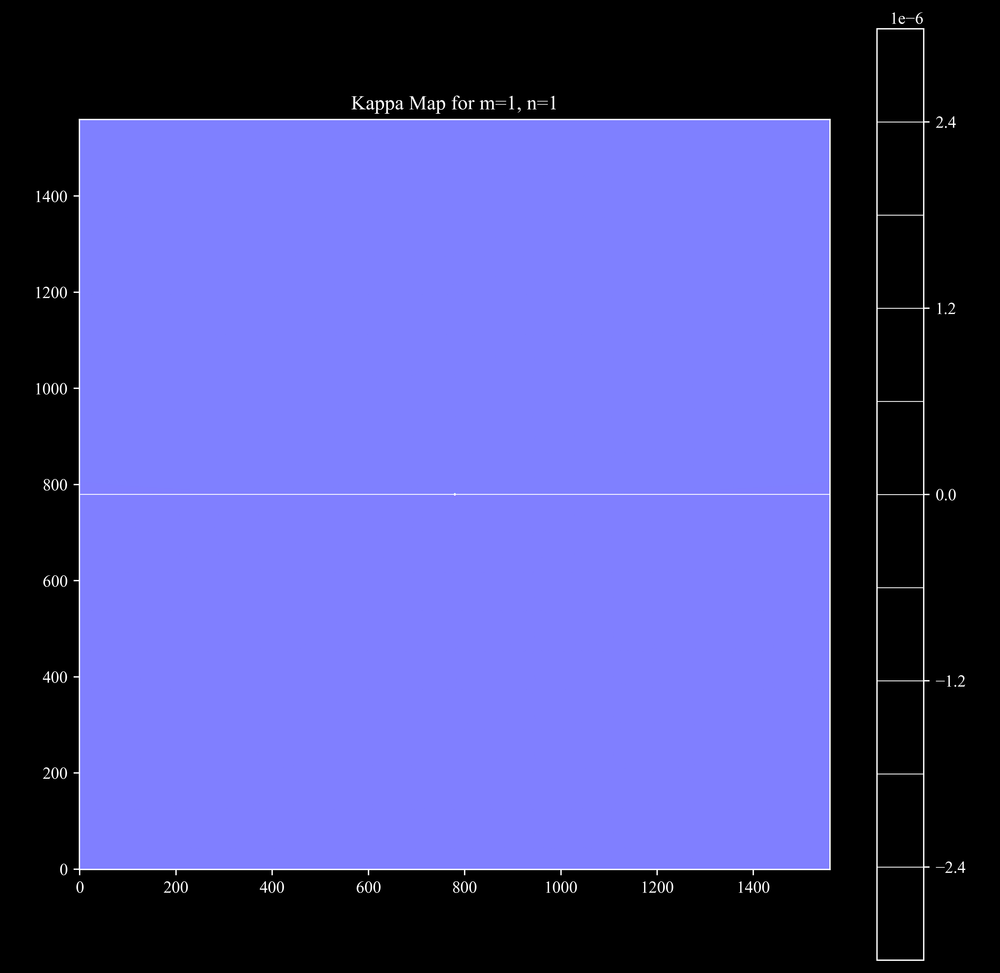

In [42]:
plt.figure(figsize=(10, 10))
plt.imshow(lens_1_1_kap, origin='lower', cmap='cool')
plt.contour(lens_1_1_kap, levels=10, alpha=1, colors ='w', linewidths=0.5, linestyles='solid')
plt.colorbar(label='Kappa', orientation='vertical')
plt.title('Kappa Map for m=1, n=1')
plt.xlabel('X Pixel')
plt.ylabel('Y Pixel')
plt.grid(False)
plt.show()

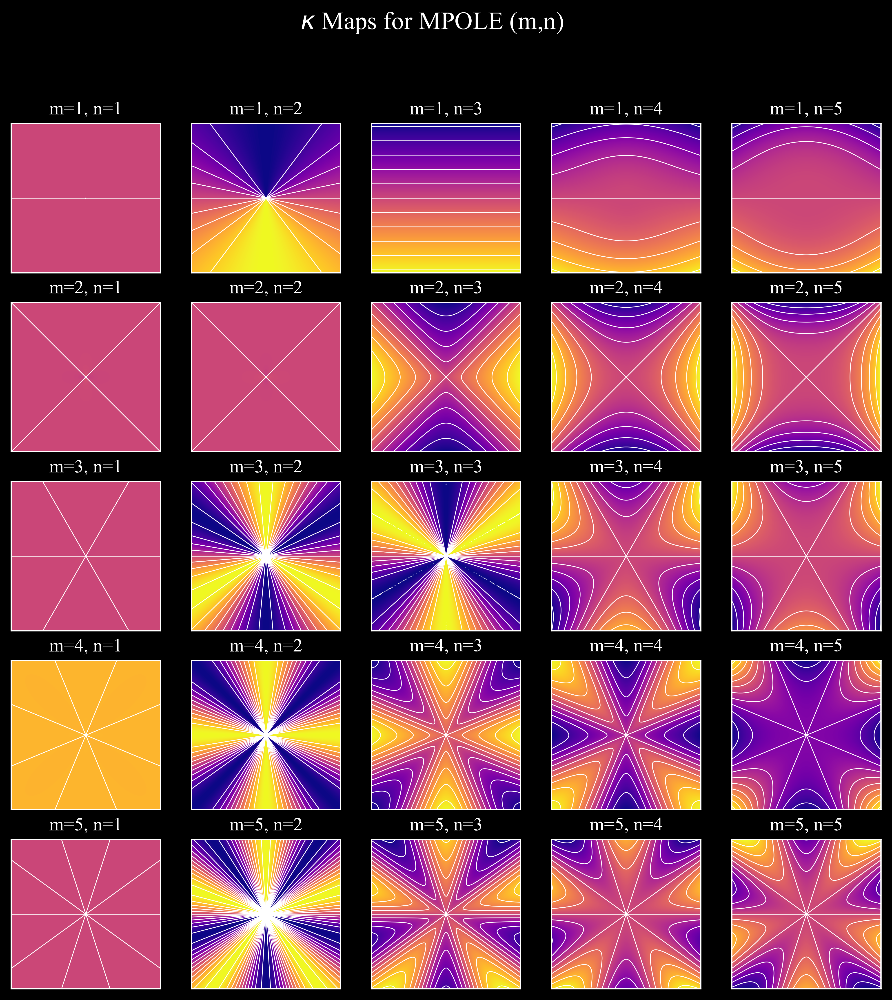

In [43]:
fig, ax = plt.subplots(5,5, figsize=(10, 10), sharex=True, sharey=True)

for i in range(len(m)):
    for j in range(len(n)):
        if fits_data_grid[i][j]:
            kap = fits_data_grid[i][j][0].data[3]
            ax[i, j].imshow(kap, origin='lower', cmap='plasma')
            ax[i, j].contour(kap, levels=10, alpha=1, colors ='w', linewidths=0.5, linestyles='solid')
            ax[i, j].set_title(f'm={m[i]}, n={n[j]}')
            ax[i, j].set_xticks([])
            ax[i, j].set_yticks([])
            ax[i, j].grid(False)

plt.suptitle('$\\kappa$ Maps for MPOLE (m,n)', fontsize=16, color='w')
plt.show()


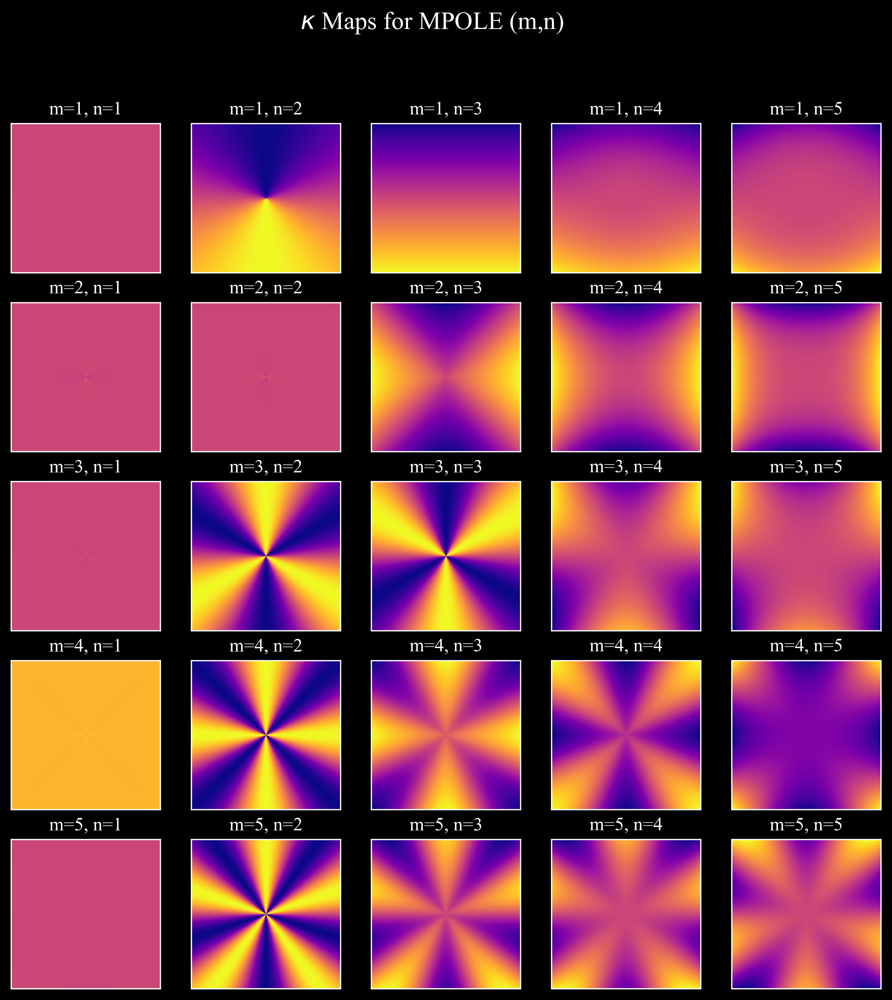

In [44]:
fig, ax = plt.subplots(5,5, figsize=(10, 10), sharex=True, sharey=True)

for i in range(len(m)):
    for j in range(len(n)):
        if fits_data_grid[i][j]:
            kap = fits_data_grid[i][j][0].data[3]
            ax[i, j].imshow(kap, origin='lower', cmap='plasma')
            ax[i, j].set_title(f'm={m[i]}, n={n[j]}')
            ax[i, j].set_xticks([])
            ax[i, j].set_yticks([])
            ax[i, j].grid(False)

plt.suptitle('$\\kappa$ Maps for MPOLE (m,n)', fontsize=16, color='w')
plt.show()


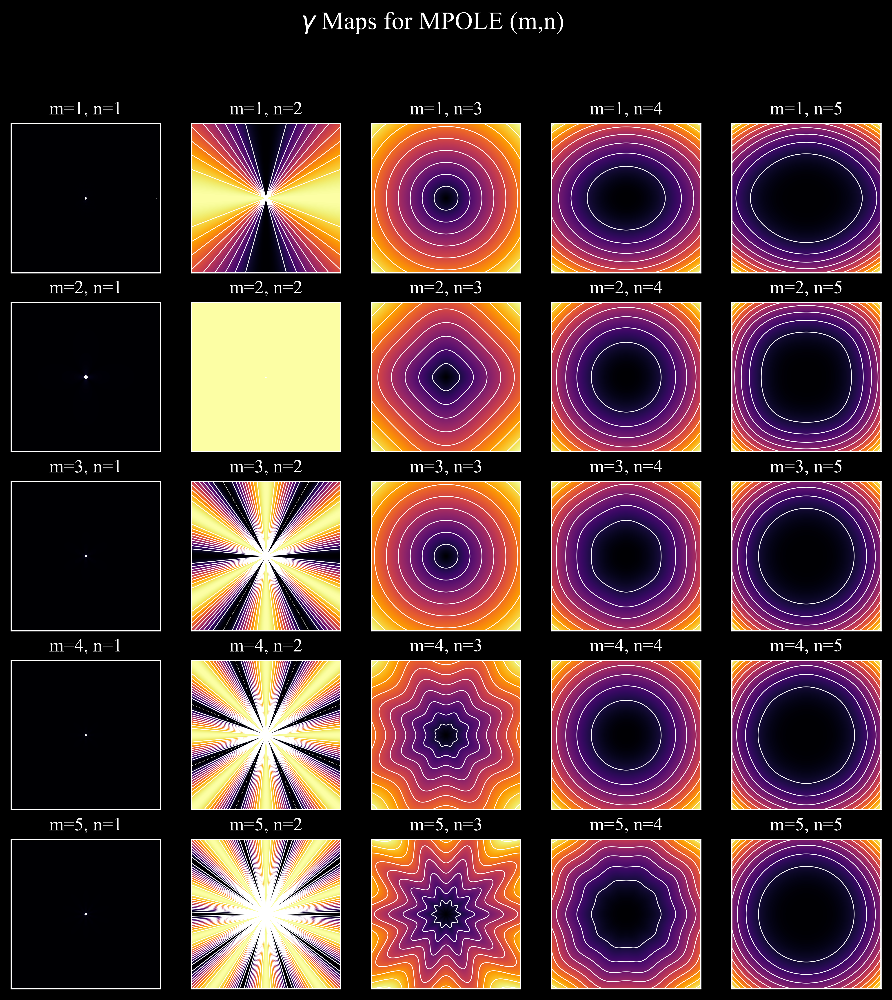

In [45]:
fig, ax = plt.subplots(5,5, figsize=(10, 10), sharex=True, sharey=True)

for i in range(len(m)):
    for j in range(len(n)):
        if fits_data_grid[i][j]:
            gam_1 = fits_data_grid[i][j][0].data[4]
            gam_2 = fits_data_grid[i][j][0].data[5]
            gam = np.sqrt(gam_1**2 + gam_2**2)
            ax[i, j].imshow(gam, origin='lower', cmap='inferno')
            ax[i, j].contour(gam, levels=10, alpha=1, colors ='w', linewidths=0.5, linestyles='solid')
            ax[i, j].set_title(f'm={m[i]}, n={n[j]}')
            ax[i, j].set_xticks([])
            ax[i, j].set_yticks([])
            ax[i, j].grid(False)

plt.suptitle('$\\gamma$ Maps for MPOLE (m,n)', fontsize=16, color='w')
plt.show()


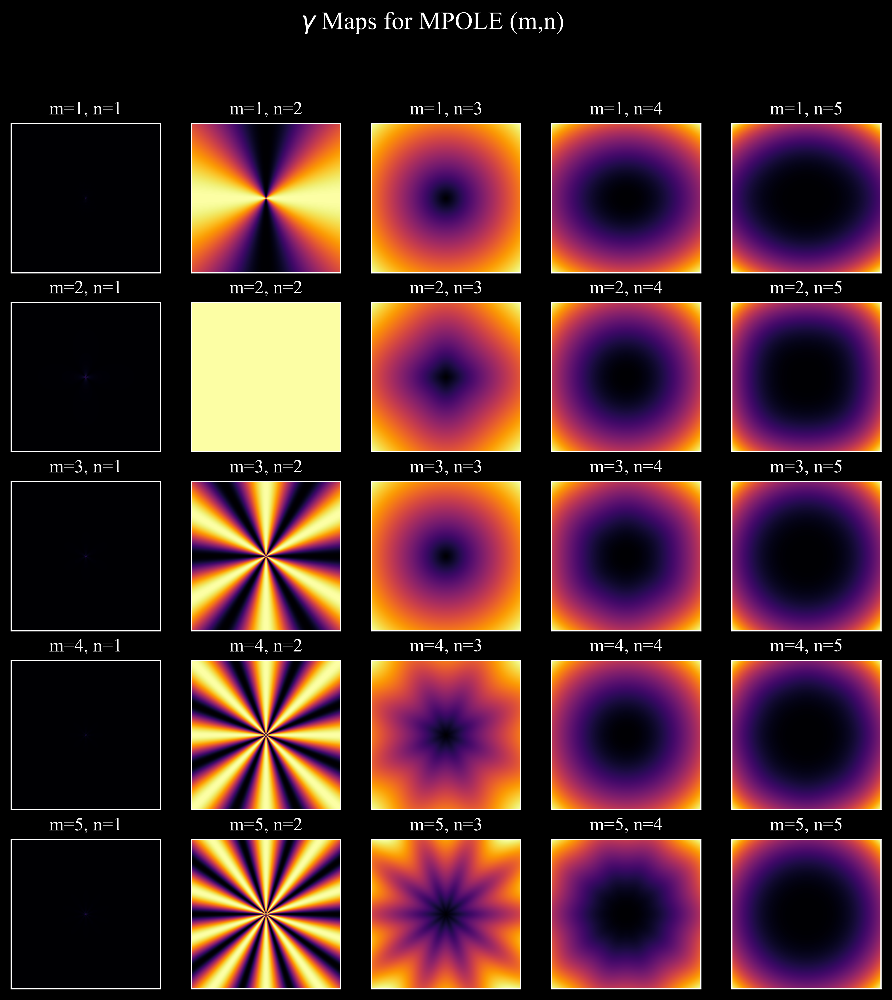

In [46]:
fig, ax = plt.subplots(5,5, figsize=(10, 10), sharex=True, sharey=True)

for i in range(len(m)):
    for j in range(len(n)):
        if fits_data_grid[i][j]:
            gam_1 = fits_data_grid[i][j][0].data[4]
            gam_2 = fits_data_grid[i][j][0].data[5]
            gam = np.sqrt(gam_1**2 + gam_2**2)
            ax[i, j].imshow(gam, origin='lower', cmap='inferno')
            ax[i, j].set_title(f'm={m[i]}, n={n[j]}')
            ax[i, j].set_xticks([])
            ax[i, j].set_yticks([])
            ax[i, j].grid(False)

plt.suptitle('$\\gamma$ Maps for MPOLE (m,n)', fontsize=16, color='w')
plt.show()


In [47]:

m = [1, 2, 3, 4, 5]
n = [1, 2, 3, 4, 5]
base_path = Path("MPOLE")

columns = ['x_crit', 'y_crit', 'x_caust', 'y_caust', 'x_crit_1', 'y_crit_1', 'x_caust_1', 'y_caust_1']



def crit_curve_data(m, n):
    file_path = base_path / f"mpole_{m}_{n}_crit.dat"
    crit_data = pd.read_csv(file_path, delim_whitespace=True, names=columns)
    return crit_data

def base_crit_curve_data(m, n):
    file_path = base_path / f"sie_{m}_{n}_crit.dat"
    base_crit_data = pd.read_csv(file_path, delim_whitespace=True, names=columns)
    return base_crit_data


In [48]:
crit_1_1 = crit_curve_data(1, 1)
crit_1_2 = crit_curve_data(1, 2)
crit_1_3 = crit_curve_data(1, 3)
crit_1_4 = crit_curve_data(1, 4)
crit_1_5 = crit_curve_data(1, 5)
crit_2_1 = crit_curve_data(2, 1)
crit_2_2 = crit_curve_data(2, 2)
crit_2_3 = crit_curve_data(2, 3)
crit_2_4 = crit_curve_data(2, 4)
crit_2_5 = crit_curve_data(2, 5)
crit_3_1 = crit_curve_data(3, 1)
crit_3_2 = crit_curve_data(3, 2)
crit_3_3 = crit_curve_data(3, 3)
crit_3_4 = crit_curve_data(3, 4)
crit_3_5 = crit_curve_data(3, 5)
crit_4_1 = crit_curve_data(4, 1)
crit_4_2 = crit_curve_data(4, 2)
crit_4_3 = crit_curve_data(4, 3)
crit_4_4 = crit_curve_data(4, 4)
crit_4_5 = crit_curve_data(4, 5)
crit_5_1 = crit_curve_data(5, 1)
crit_5_2 = crit_curve_data(5, 2)
crit_5_3 = crit_curve_data(5, 3)
crit_5_4 = crit_curve_data(5, 4)
crit_5_5 = crit_curve_data(5, 5)

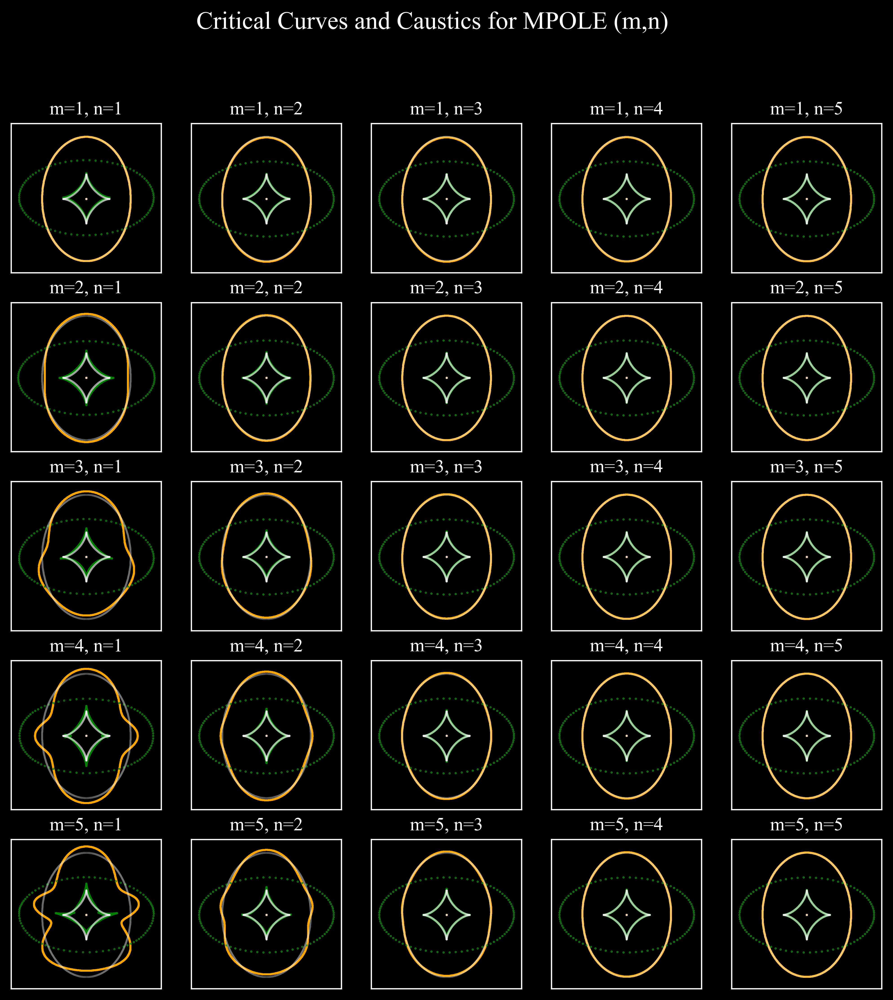

In [49]:
fig, ax = plt.subplots(5,5, figsize=(10, 10), sharex=True, sharey=True)

for i in range(len(m)):
    for j in range(len(n)):
        crit_data = crit_curve_data(m[i], n[j])
        base_crit = base_crit_curve_data(m[i], n[j])
        if not crit_data.empty:
            ax[i, j].scatter(crit_data['x_crit'], crit_data['y_crit'], color='orange', label='Critical Curve', s=0.1)
            ax[i, j].scatter(crit_data['x_caust'], crit_data['y_caust'], color='green', label='Caustic Curve', s=0.1)
            ax[i, j].scatter(base_crit['x_crit'], base_crit['y_crit'], color='w', label='Base Critical Curve', s=0.1, alpha=0.05)
            ax[i, j].scatter(base_crit['x_caust'], base_crit['y_caust'], color='w', label='Base Caustic Curve', s=0.1, alpha=0.05)
            ax[i, j].set_title(f'm={m[i]}, n={n[j]}')
            ax[i, j].set_xticks([])
            ax[i, j].set_yticks([])
            ax[i, j].grid(False)

plt.suptitle('Critical Curves and Caustics for MPOLE (m,n)', fontsize=16, color='w')
plt.show()

In [50]:

m = [1, 2, 3, 4, 5]
n = [1, 2, 3, 4, 5]
base_path = Path("MPOLE")

# Create a 2D list (a list of lists)
fits_data_grid = []

for i, m_val in enumerate(m):
    # Create a new row for each value in m
    row = []
    for j, n_val in enumerate(n):
        file_path = base_path / f"sie_{m_val}_{n_val}_lens.fits"
        try:
            row.append(fits.open(file_path))
        except FileNotFoundError:
            row.append(None)
    
    # Add the completed row to the main grid
    fits_data_grid.append(row)

# --- How to use this structure ---

# Access by index: get the data for the 3rd m-value and 4th n-value
# m[2] is 3, n[3] is 4. Indices are 0-based.
hdul_by_index = fits_data_grid[2][3] 

if hdul_by_index:
    print("\nInfo for m=3, n=4 (accessed by index [2][3]):")
    hdul_by_index.info()


Info for m=3, n=4 (accessed by index [2][3]):
Filename: MPOLE/sie_3_4_lens.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      27   (1560, 1560, 8)   float32   


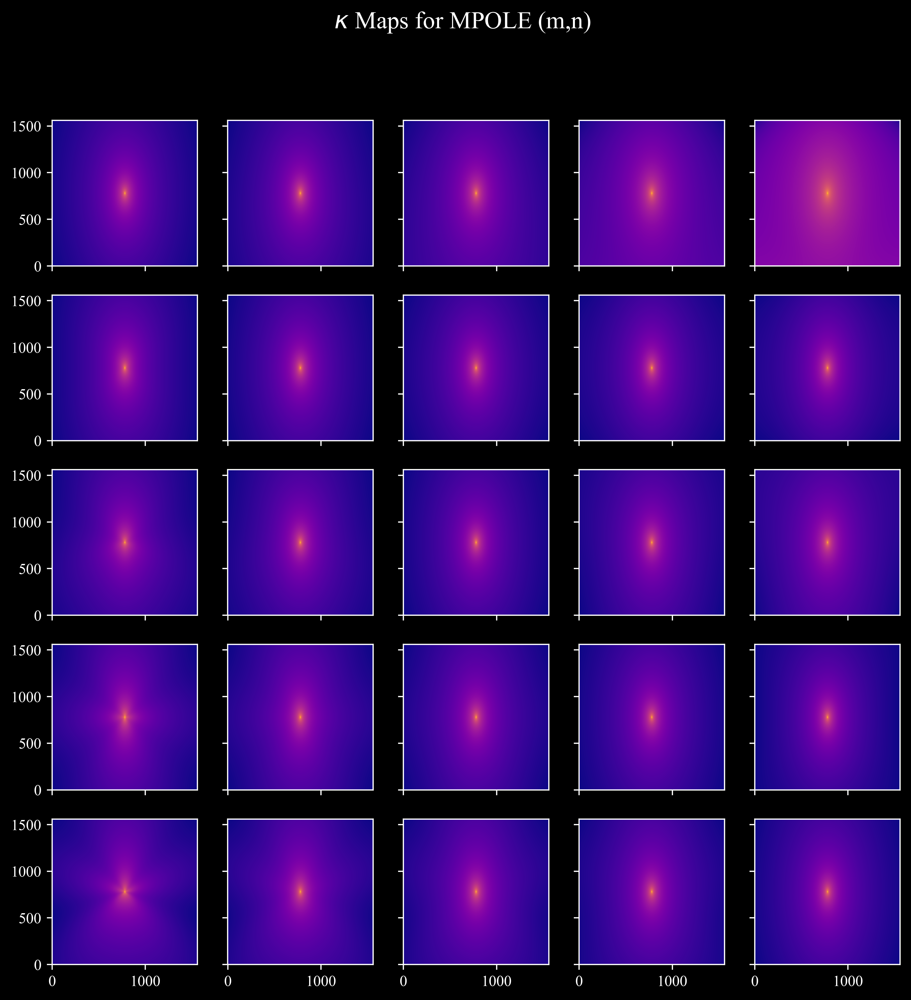

In [52]:
fig, ax = plt.subplots(5,5, figsize=(10, 10), sharex=True, sharey=True)

for i in range(len(m)):
    for j in range(len(n)):
        if fits_data_grid[i][j]:
            kap = fits_data_grid[i][j][0].data[3]
            center_x, center_y = kap.shape[1] // 2, kap.shape[0] // 2
            half_size = 0
            if half_size > 0:
                zoomed_kap = kap[center_y - half_size:center_y + half_size, center_x - half_size:center_x + half_size]
            else:
                zoomed_kap = kap
            ax[i, j].imshow(
                zoomed_kap, 
                origin='lower', 
                cmap='plasma', 
                norm=LogNorm(vmin=np.nanmin(zoomed_kap[zoomed_kap > 0]), vmax=np.nanmax(zoomed_kap))
            )
            # ax[i, j].contour(
            #     zoomed_kap, 
            #     levels=10, 
            #     alpha=1, 
            #     colors='w', 
            #     linewidths=0.5, 
            #     linestyles='solid', 
            #     norm=LogNorm(vmin=np.nanmin(zoomed_kap[zoomed_kap > 0]), vmax=np.nanmax(zoomed_kap))
            # )
            # ax[i, j].set_title(f'm={m[i]}, n={n[j]}')
            # ax[i, j].set_xticks([])
            # ax[i, j].set_yticks([])
            # ax[i, j].grid(False)

plt.suptitle('$\\kappa$ Maps for MPOLE (m,n)', fontsize=16, color='w')
plt.show()

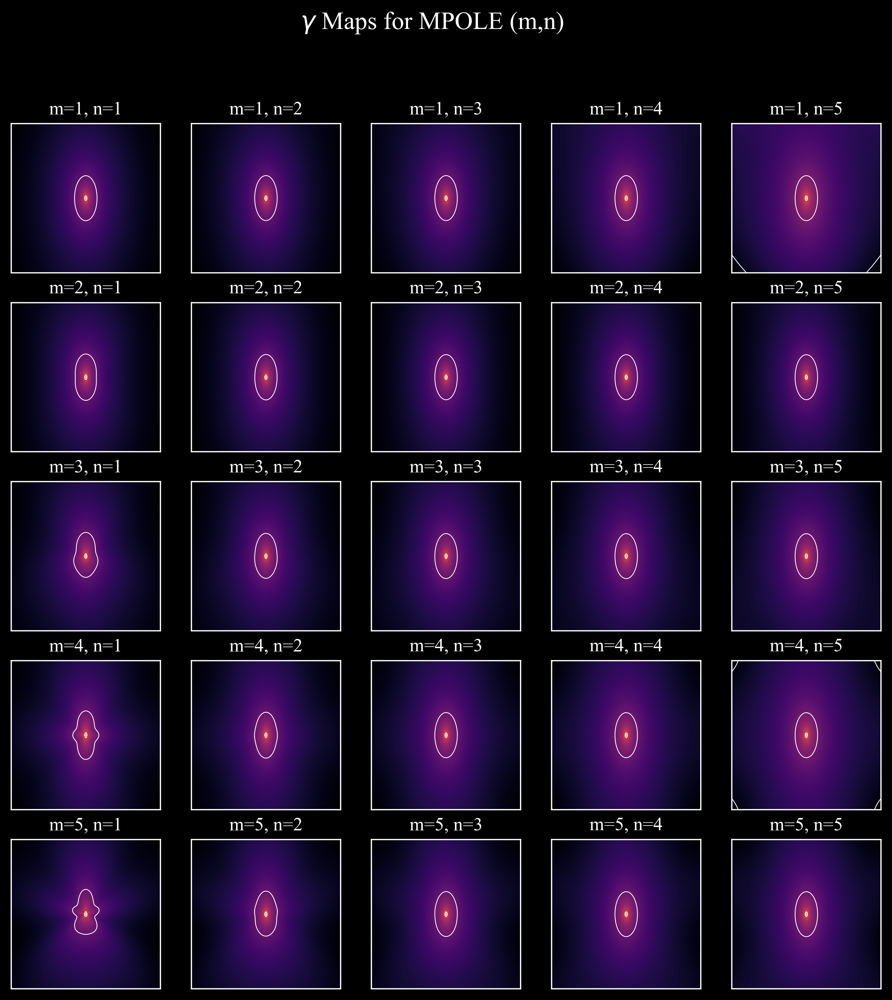

In [54]:
fig, ax = plt.subplots(5,5, figsize=(10, 10), sharex=True, sharey=True)

for i in range(len(m)):
    for j in range(len(n)):
        if fits_data_grid[i][j]:
            gam_1 = fits_data_grid[i][j][0].data[4]
            gam_2 = fits_data_grid[i][j][0].data[5]
            gam = np.sqrt(gam_1**2 + gam_2**2)
            ax[i, j].imshow(gam, origin='lower', cmap='inferno', norm=LogNorm(vmin=gam.min(), vmax=gam.max()))
            ax[i, j].contour(gam, levels=10, alpha=1, colors ='w', linewidths=0.5, linestyles='solid', norm=LogNorm(vmin=gam.min(), vmax=gam.max()))
            ax[i, j].set_title(f'm={m[i]}, n={n[j]}')
            ax[i, j].set_xticks([])
            ax[i, j].set_yticks([])
            ax[i, j].grid(False)

plt.suptitle('$\\gamma$ Maps for MPOLE (m,n)', fontsize=16, color='w')
plt.show()
